# Import Libraries

In [1]:
from insightface.app import FaceAnalysis
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
from icrawler.builtin import BingImageCrawler
import json

# Prepare the model

In [2]:
model = FaceAnalysis(name='antelopev2',
                     download=True,
                     root="./",
                     providers=['CPUExecutionProvider'])
model.prepare(ctx_id=-1)

Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: ./models/antelopev2/1k3d68.onnx landmark_3d_68 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: ./models/antelopev2/2d106det.onnx landmark_2d_106 ['None', 3, 192, 192] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: ./models/antelopev2/genderage.onnx genderage ['None', 3, 96, 96] 0.0 1.0
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: ./models/antelopev2/glintr100.onnx recognition ['None', 3, 112, 112] 127.5 127.5
Applied providers: ['CPUExecutionProvider'], with options: {'CPUExecutionProvider': {}}
find model: ./models/antelopev2/scrfd_10g_bnkps.onnx detection [1, 3, '?', '?'] 127.5 128.0
set det-size: (640, 640)


# Scrape celeberties images online

In [ ]:
def download_celeb_images(celeb_names, max_num=10, output_dir="celeb_images"):
    os.makedirs(output_dir, exist_ok=True)

    for name in celeb_names:
        print(f"Downloading images for: {name}")
        name_folder = os.path.join(output_dir, name.replace(" ", "_"))
        os.makedirs(name_folder, exist_ok=True)

        crawler = BingImageCrawler(storage={'root_dir': name_folder})
        crawler.crawl(keyword=name + " face", max_num=max_num)

if __name__ == "__main__":
    # Sample list (you can use celebrity_list.csv it has more people)
    celeb_list = [
        "Tom Cruise", "Leonardo DiCaprio", "Brad Pitt", "Robert Downey Jr.",
        "Eminem", "Sabrina Carpenter", "Selena Gomez", "Kendrick Lamar",
        "Lionel Messi", "Viktor Gyokeres", "Virgil van Dijk", "Kylian Mbappe",
        "Xi Jinping", "Donald Trump", "Barak Obama", "Joe Biden", "Vladimir Putin",
        "Elon Musk", "Steve Jobs", "Jeff Bezos", "Bill Gates", "Mark Zuckerberg", "Sam Altman"
    ]

    download_celeb_images(celeb_list, max_num=8)

# Create Embeddings Map

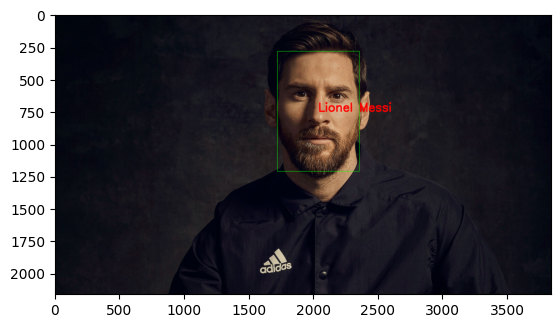

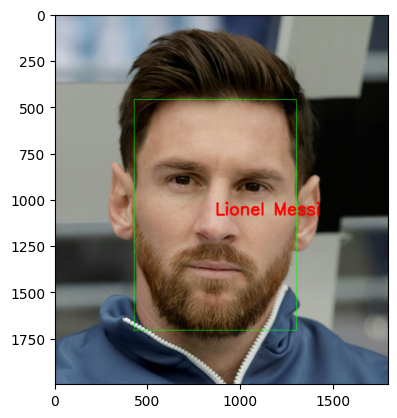

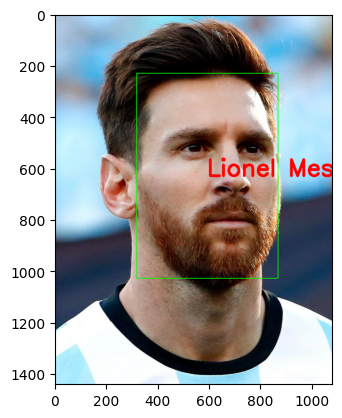

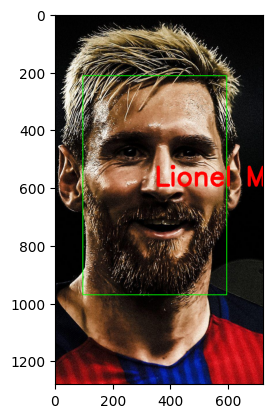

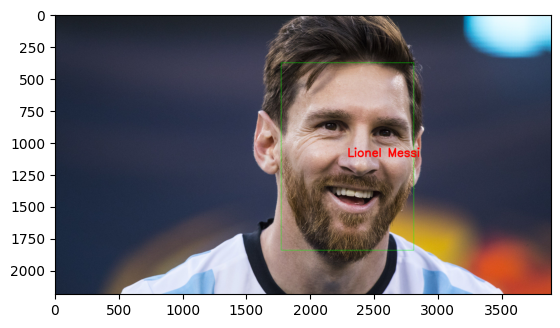

...

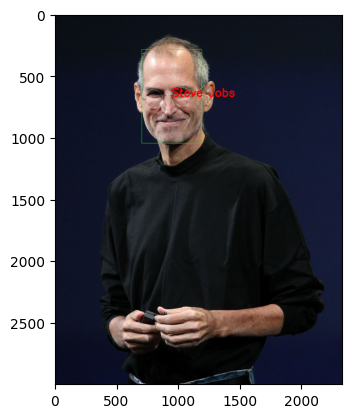

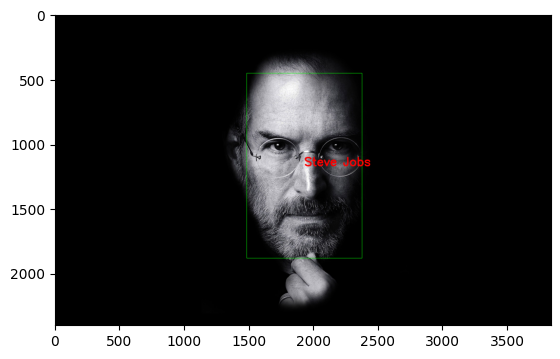

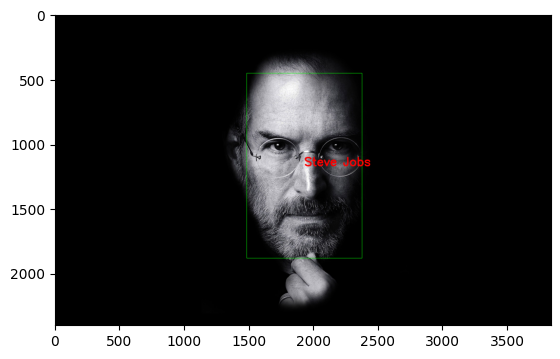

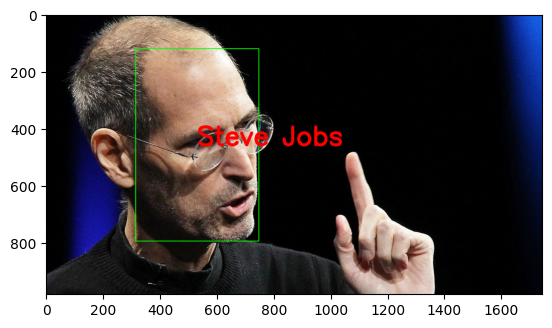

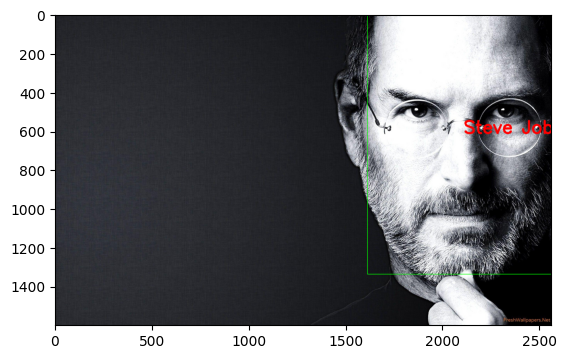

In [5]:
celebs = os.listdir("celeb_images")
embeddings = dict()
for celeb in celebs:
    im = os.listdir(f"celeb_images/{celeb}")
    for i in im:
        image = cv2.imread(os.path.join("celeb_images", celeb, i))
        if len(model.get(image)) > 0:
            faces = model.get(image)
            for face in faces:
                box = face.bbox
                cv2.rectangle(image, (int(box[0]), int(box[1])), (int(box[2]), int(box[3])),(0, 255, 0), 2)
                cv2.putText(image, celeb.replace("_", " "), ((int(box[0])+int(box[2]))//2, (int(box[1])+int(box[3]))//2), cv2.FONT_HERSHEY_SIMPLEX, 3, (0,0,255), 10)

                plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

                plt.show()
                if celeb in embeddings.keys():
                    embeddings[celeb].append(face.embedding.tolist())
                else:
                    embeddings[celeb] = [face.embedding.tolist()]
        else:
            continue

# Save Embeddings Map

In [6]:
with open("embeddings_mapper.json", "w") as f:
    j = json.dump(embeddings, f, indent=4)

# Functions to help with recognition

In [15]:
def cosine_similarity(a, b):
    a = a.squeeze()
    b = np.array(b).squeeze()
    return np.dot(a, b) / (np.linalg.norm(a) * np.linalg.norm(b))

def get_face_embedding(image_path):
    img = cv2.imread(image_path)
    faces = model.get(img)
    if not faces:
        return None
    return faces[0].embedding 

def match_face(query_embedding, database, threshold=0.3):
    best_match = None
    best_score = -1

    for name, embedding in database.items():
        for emb in embedding:
            sim = (cosine_similarity(query_embedding, emb))
            if sim > best_score:
                best_score = sim
                best_match = name if sim >= threshold else None

    return best_match, best_score

# Test

In [16]:
path = "celeb_images/Eminem/000002.jpg"
emb = get_face_embedding(path)

match_face(emb, embeddings)

('Eminem', np.float64(1.0000000071285615))